In [101]:
%run model.ipynb
%run data.ipynb

In [102]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [103]:
X_train, X_test, y_train, y_test = train_test_split(x, y,
                                                    random_state=1)
regr.fit(X_train, y_train)
#svr.fit(X_train, y_train)

Iteration 1, loss = 30.93200231
Iteration 2, loss = 20.04285295
Iteration 3, loss = 19.63664346
Iteration 4, loss = 19.48729186
Iteration 5, loss = 19.37759562
Iteration 6, loss = 19.31775574
Iteration 7, loss = 19.26417408
Iteration 8, loss = 19.20057208
Iteration 9, loss = 19.14032674
Iteration 10, loss = 19.05152126
Iteration 11, loss = 18.73198339
Iteration 12, loss = 18.61114631
Iteration 13, loss = 18.51714401
Iteration 14, loss = 18.46495877
Iteration 15, loss = 18.44938863
Iteration 16, loss = 18.39398987
Iteration 17, loss = 18.37558551
Iteration 18, loss = 18.35493149
Iteration 19, loss = 18.30197128
Iteration 20, loss = 18.26787688
Iteration 21, loss = 18.23535631
Iteration 22, loss = 18.22139119
Iteration 23, loss = 18.19945049
Iteration 24, loss = 18.16971224
Iteration 25, loss = 18.16216286
Iteration 26, loss = 18.14878590
Iteration 27, loss = 18.13242408
Iteration 28, loss = 18.13350285
Iteration 29, loss = 18.12487256
Iteration 30, loss = 18.10865676
Iteration 31, loss 

MLPRegressor(hidden_layer_sizes=(16, 16), learning_rate='adaptive',
             verbose=True)

Text(0, 0.5, 'loss value')

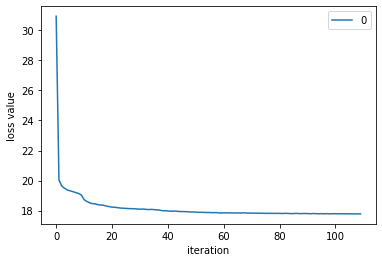

In [104]:
pd.DataFrame(regr.loss_curve_).plot()
plt.xlabel('iteration')
plt.ylabel('loss value')

Text(0, 0.5, 'Measured')

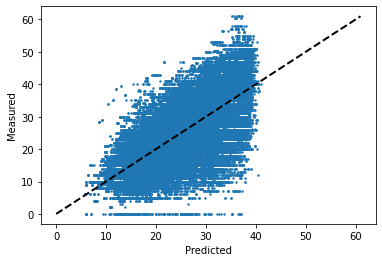

In [105]:
#predict = svr.predict(x)
#svr.score(x,y)
predict = regr.predict(X_test)
regr.score(X_test,y_test)
plt.scatter(predict,y_test,s=2)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Predicted')
plt.ylabel('Measured')

In [106]:
# The mean squared error
from math import sqrt

print("Root mean squared error: %.2f"
      % sqrt(mean_squared_error(y_test, predict)))
# The absolute squared error
print("Mean absolute error: %.2f"
      % mean_absolute_error(y_test, predict))
# Explained variance score: 1 is perfect prediction
print('R-squared: %.2f' % r2_score(y_test, predict))

Root mean squared error: 5.99
Mean absolute error: 4.59
R-squared: 0.55


In [107]:
predict = regr.predict(test_without_ID)
val = pd.DataFrame({'預測乳量':predict})
x = test.join(val)
x_group = x.groupby(['ID']).mean()
x_index = list(range(0,x_group.shape[0]))
x_group.index

Int64Index([  480,   742,   743,   744,   745,   793,   794,   800,   801,
              802,
            ...
            37476, 37477, 37478, 37479, 37480, 37481, 37482, 37483, 37484,
            37485],
           dtype='int64', name='ID', length=4263)

Text(0, 0.5, 'predict value')

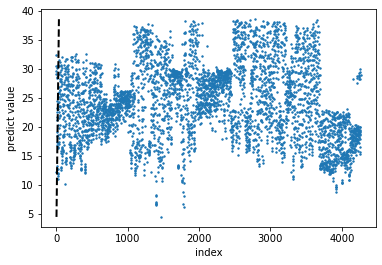

In [108]:
plt.scatter(x_index,x_group['預測乳量'].values,s=2)
#plt.plot(predict_y, predict_y, 'ro')
plt.plot([x_group['預測乳量'].values.min(), x_group['預測乳量'].values.max()], 
         [x_group['預測乳量'].values.min(),x_group['預測乳量'].values.max()], 'k--', lw=2)
plt.xlabel('index')
plt.ylabel('predict value')

In [109]:
for index in range(x_group.shape[0]):
    submission.loc[index, ['1']] = x_group['預測乳量'].values[index]
submission

,ID,1
0,480,12.355167
1,742,29.631023
2,743,32.365454
3,744,30.544824
4,745,29.131003
...,...,...
4258,37481,20.054437
4259,37482,28.304595
4260,37483,29.974729
4261,37484,29.565109


In [110]:
submission.columns = ['ID','預測乳量']
submission.to_csv('result.csv',index = False)